In [1]:
# Plotly Express -> Plotly Graph Objects (what Seabors is to Matplotlib)
    # Use px.plot_type for quick plotting
    # Using fig = px.plot_type... + fig.update_layout, fig.update_traces for more customization
        # fig = px.bar(df_eu, x='country', y='pop', text='pop')
        # fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
        # fig.update_layout(uniformtext_minsize=8, xaxis_tickangle=-45)
    # 'IPLOT' is Pandas backend - to use DF.iplot() vs. px.plot(DF)
        # takes 'kind' parameter, same as DF.plot(kind='')
    # DONT REALLY SEE THE NEED TO USE GO FIGURE OBJECT DIRECTLY

In [2]:
!Jupyter --version

jupyter core     : 4.6.3
jupyter-notebook : 6.1.4
qtconsole        : 4.7.7
ipython          : 7.19.0
ipykernel        : 5.3.4
jupyter client   : 6.1.7
jupyter lab      : 2.2.6
nbconvert        : 6.0.7
ipywidgets       : 7.5.1
nbformat         : 5.0.8
traitlets        : 5.0.5


In [3]:
import pandas as pd
import numpy as np 

# Scipy 2021 Presentation (cleanest usage)
* https://github.com/nicolaskruchten/scipy2021
* https://www.youtube.com/watch?v=FpCgG85g2Hw&t=244s

In [4]:
import plotly.express as px

In [5]:
px.data.gapminder().head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4
4,Afghanistan,Asia,1972,36.088,13079460,739.981106,AFG,4


In [6]:
df = px.data.gapminder().query('year==2007')
df.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32


In [7]:
#Univariate
px.strip(df, x='lifeExp', hover_name='country', color='continent')

In [8]:
px.histogram(df, x='lifeExp', hover_name='country', color='continent', marginal='rug', y='pop')

In [9]:
px.histogram(df, x='lifeExp', hover_name='country', color='continent', marginal='rug', facet_col='continent')  #facet_col

In [10]:
px.bar(df, x='continent', y='pop', color='lifeExp', hover_name='country')

In [11]:
#Part to whole relationship -> person-> country-> continent
px.sunburst(df, values='pop', path=['continent', 'country'], color='lifeExp')

In [12]:
#TreeMap
px.treemap(df, values='pop', path=['continent', 'country'], color='lifeExp')

In [13]:
px.choropleth(df, color='lifeExp', locations ='iso_alpha', hover_name='country')

In [14]:
# Multi-variate
px.scatter(df, y='lifeExp', x='gdpPercap', hover_name='country', size='pop', size_max=60, log_x=True, color='continent')

In [15]:
fig = px.scatter(df, y='lifeExp', x='gdpPercap', hover_name='country', size='pop', size_max=60, log_x=True, color='continent')

# cannot render json file in Jupyter Notebook
# fig.show('json')
print(fig)

Figure({
    'data': [{'hovertemplate': ('<b>%{hovertext}</b><br><br>con' ... '=%{marker.size}<extra></extra>'),
              'hovertext': array(['Afghanistan', 'Bahrain', 'Bangladesh', 'Cambodia', 'China',
                                  'Hong Kong, China', 'India', 'Indonesia', 'Iran', 'Iraq', 'Israel',
                                  'Japan', 'Jordan', 'Korea, Dem. Rep.', 'Korea, Rep.', 'Kuwait',
                                  'Lebanon', 'Malaysia', 'Mongolia', 'Myanmar', 'Nepal', 'Oman',
                                  'Pakistan', 'Philippines', 'Saudi Arabia', 'Singapore', 'Sri Lanka',
                                  'Syria', 'Taiwan', 'Thailand', 'Vietnam', 'West Bank and Gaza',
                                  'Yemen, Rep.'], dtype=object),
              'legendgroup': 'Asia',
              'marker': {'color': '#636efa',
                         'size': array([  31889923,     708573,  150448339,   14131858, 1318683096,    6980412,
                                   

In [16]:
fig = px.scatter(df, y="lifeExp", x="gdpPercap", color="continent", log_x=True, size="pop", size_max=60,
                 hover_name="country", height=600, width=1000, template="simple_white", 
                 color_discrete_sequence=px.colors.qualitative.G10,
                 title="Health vs Wealth 2007",
                 labels=dict(
                     continent="Continent", pop="Population",
                     gdpPercap="GDP per Capita (US$, price-adjusted)", 
                     lifeExp="Life Expectancy (years)"))

fig.update_layout(font_family="Rockwell",
                  legend=dict(orientation="h", title="", y=1.1, x=1, xanchor="right", yanchor="bottom"))
fig.update_xaxes(tickprefix="$", range=[2,5], dtick=1)
fig.update_yaxes(range=[30,90])
fig.add_hline((df["lifeExp"]*df["pop"]).sum()/df["pop"].sum(), line_width=1, line_dash="dot")
fig.add_vline((df["gdpPercap"]*df["pop"]).sum()/df["pop"].sum(), line_width=1, line_dash="dot")
fig.show()
# fig.write_html("gapminder_2007.html") # interactive export

In [17]:
import xarray as xr
airtemps = xr.tutorial.open_dataset('air_temperature').air.sel(lon=250.0)
airtemps.T.head()

<xarray.DataArray 'air' (lat: 5, time: 5)>
array([[246.5    , 244.     , 242.2    , 239.79999, 239.29999],
       [242.     , 241.59999, 239.59999, 236.09999, 236.     ],
       [240.39   , 240.59999, 239.89   , 238.5    , 238.7    ],
       [242.7    , 244.09999, 243.79999, 243.59999, 242.89   ],
       [247.29999, 249.2    , 248.89   , 248.29999, 248.29999]], dtype=float32)
Coordinates:
  * lat      (lat) float32 75.0 72.5 70.0 67.5 65.0
    lon      float32 250.0
  * time     (time) datetime64[ns] 2013-01-01 2013-01-01T06:00:00 ... 2013-01-02
Attributes:
    long_name:     4xDaily Air temperature at sigma level 995
    units:         degK
    precision:     2
    GRIB_id:       11
    GRIB_name:     TMP
    var_desc:      Air temperature
    dataset:       NMC Reanalysis
    level_desc:    Surface
    statistic:     Individual Obs
    parent_stat:   Other
    actual_range:  [185.16 322.1 ]

In [18]:
fig = px.imshow(airtemps.T, origin='lower')
fig.show()

In [19]:
df = px.data.wind()
display(df.head())
display(df.dtypes)
px.bar_polar(df, r="frequency", theta="direction", height=600,
                   color="strength", template="plotly_dark",
                   color_discrete_sequence= px.colors.sequential.Plasma_r)

,direction,strength,frequency
0,N,0-1,0.5
1,NNE,0-1,0.6
2,NE,0-1,0.5
3,ENE,0-1,0.4
4,E,0-1,0.4


direction     object
strength      object
frequency    float64
dtype: object

In [20]:
df = px.data.iris()
px.parallel_coordinates(df, color="species_id", labels={"species_id": "Species",
                  "sepal_width": "Sepal Width", "sepal_length": "Sepal Length",
                  "petal_width": "Petal Width", "petal_length": "Petal Length", },
                    color_continuous_scale=px.colors.diverging.Tealrose, color_continuous_midpoint=2)

In [21]:
df = px.data.election()
display(df.sort_values(by='district').head())
px.scatter_ternary(df, a="Joly", b="Coderre", c="Bergeron", color="winner", size="total", hover_name="district",
                   size_max=15, color_discrete_map = {"Joly": "blue", "Bergeron": "green", "Coderre":"red"} )


,district,Coderre,Bergeron,Joly,total,winner,result,district_id
0,101-Bois-de-Liesse,2481,1829,3024,7334,Joly,plurality,101
1,102-Cap-Saint-Jacques,2525,1163,2675,6363,Joly,plurality,102
2,11-Sault-au-Récollet,3348,2770,2532,8650,Coderre,plurality,11
3,111-Mile-End,1734,4782,2514,9030,Bergeron,majority,111
4,112-DeLorimier,1770,5933,3044,10747,Bergeron,majority,112


In [22]:
df = px.data.election()
px.scatter_3d(df, x="Joly", y="Coderre", z="Bergeron", color="winner", size="total", hover_name="district",
                  symbol="result", color_discrete_map = {"Joly": "blue", "Bergeron": "green", "Coderre":"red"})

In [23]:
# Dont show up the dash-app in jupyter
# from jupyter_dash import JupyterDash
# from dash import html
# from dash import dcc
# from dash.dependencies import Input, Output
# import plotly.express as px
# df = px.data.gapminder()

# app = JupyterDash(__name__)

# app.layout = html.Div(children = [
#  dcc.Dropdown(id="year", value=2007, clearable=False,
#    options=[{"label": y, "value": y} for y in df['year'].unique()]),
#  dcc.Graph(id="graph", figure={})
#])

# @app.callback(Output('graph', 'figure'), Input('year', 'value'))
# def cb(year):
#    df_year = df.query("year == @year")
#    return px.scatter(df_year, x="gdpPercap", y="lifeExp", size="pop",
#          log_x=True, size_max=60, hover_name="country", height=400)

# app.run_server(mode="jupyterlab")

# Udemy notes - mainly using iplot (not the best approach)

In [24]:
import chart_studio.plotly as py
import plotly.express as px
import cufflinks as cf
%matplotlib inline

# to make things work offline
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot, plot
init_notebook_mode(connected=True)
cf.go_offline()

In [25]:
df1 = pd.DataFrame(np.random.randn(100,4), columns=list('abcd'))
df1.head()

,a,b,c,d
0,0.123933,-0.199654,0.266532,-1.212070
1,1.267401,-0.449668,1.492848,0.384858
2,-1.362114,-0.698916,0.853230,-0.246576
3,1.044361,1.049691,0.504060,0.303789
4,-1.808761,1.464582,-1.208066,1.088172


<AxesSubplot:>

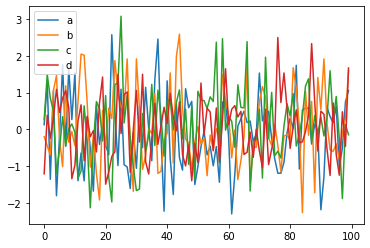

In [26]:
df1.plot()

In [27]:
df1.iplot()

In [28]:
df1.iplot(kind='scatter', x='a', y='b', mode='markers', xTitle='A', yTitle='B') #mode=markers to get dots instead of lines

In [29]:
df1.sum().iplot(kind='bar')

In [30]:
df1.iplot(kind='box')

In [31]:
df1.iplot(kind='hist', bins=10)

In [32]:
df3 = pd.DataFrame({'Strike':[1,2,3,4,5],'Price':[1,2,3,4,5], 'Maturity':[1,2,3,4,5]})
display(df3.head())
df3.iplot(kind='surface')

,Strike,Price,Maturity
0,1,1,1
1,2,2,2
2,3,3,3
3,4,4,4
4,5,5,5


In [33]:
df1['a'] = df1['a']+3
df1['b'] = df1['b']+2
df1_edit = df1[['a','b']]
df1_edit.iplot(kind='spread',colors=['green','red'])       #Unclear on the why both +/- spreads are shown for same pair

C:\Users\uditg\anaconda3\lib\site-packages\cufflinks\plotlytools.py:849: FutureWarning:

The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead

C:\Users\uditg\anaconda3\lib\site-packages\cufflinks\plotlytools.py:850: FutureWarning:

The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead



In [34]:
df1.iplot(kind='bubble', x='a', y='b', size='c')

In [35]:
df1.scatter_matrix()  #similar to Seaborn pairplot

## Choropleth Maps - use above approach instead! this is unnecessarily complicated

In [36]:
import plotly.graph_objects as go

# Create DATA and LAYOUT objects
data = dict(type = 'choropleth',
            locations = ['AZ','CA','NY'],
            locationmode = 'USA-states',
#             colorscale= 'Portland',  
#             text= ['text1','text2','text3'],
            z=[1.0,2.0,3.0],
            colorbar = {'title':'Colorbar Title'})

layout = dict(geo = {'scope':'usa'})

In [37]:
choromap = go.Figure(data = data, layout = layout)
choromap.show()

In [38]:
path ='C:\\Users\\uditg\\Documents\\GitHub\\Udemy-Python-for-DS\\09-Geographical-Plotting\\'
dfagri = pd.read_csv(path+'2011_US_AGRI_Exports')
display(dfagri.head(2))

data = dict(type='choropleth',
           colorscale='sunset',
           locations=dfagri['code'],
           locationmode = 'USA-states',
           z = dfagri['total exports'],
           text = dfagri['text'],
           colorbar = {'title':'Millions USD'},
           marker = dict(line = dict(color='white', width=1)
                        )
           )
layout = dict(title='2011 US Agri Exports',
             geo = dict(scope='usa', showlakes=True, lakecolor='rgb(85,173,240)'))

choromap = go.Figure(data = [data],layout = layout)
choromap.show()

,code,state,category,total exports,beef,pork,poultry,dairy,fruits fresh,fruits proc,total fruits,veggies fresh,veggies proc,total veggies,corn,wheat,cotton,text
0,AL,Alabama,state,1390.63,34.4,10.6,481.0,4.06,8.0,17.1,25.11,5.5,8.9,14.33,34.9,70.0,317.61,Alabama<br>Beef 34.4 Dairy 4.06<br>Fruits 25.1...
1,AK,Alaska,state,13.31,0.2,0.1,0.0,0.19,0.0,0.0,0.00,0.6,1.0,1.56,0.0,0.0,0.00,Alaska<br>Beef 0.2 Dairy 0.19<br>Fruits 0.0 Ve...


In [39]:
dfgdp = pd.read_csv(path+'2014_World_GDP')
display(dfgdp.head(2))

data = dict(type='choropleth',
           colorscale='Jet',
           locations=dfgdp['CODE'],
#            locationmode = 'ISO-3',     # optional in this case!
           z = dfgdp['GDP (BILLIONS)'],
           text = dfgdp['COUNTRY'],
           colorbar = {'title':'$ Bn'},
           marker = dict(line = dict(color='white', width=1)
                        )
           )
layout = dict(title='2014 GDP',
             geo = dict(scope='world', 
                        showlakes=True,
                        lakecolor='rgb(85,173,240)',
                        projection={'type':'natural earth'}))

choromap = go.Figure(data = [data],layout = layout)
choromap.show()

,COUNTRY,GDP (BILLIONS),CODE
0,Afghanistan,21.71,AFG
1,Albania,13.40,ALB


# Youtube Video - Derek Banas (switching b/w go.Figure vs. px.plot)
* https://www.youtube.com/watch?v=GGL6U0k8WYA

In [40]:
import plotly.express as px
import plotly.graph_objects as go

In [41]:
df_stocks = px.data.stocks()
df_stocks.head()

,date,GOOG,AAPL,AMZN,FB,NFLX,MSFT
0,2018-01-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-08,1.018172,1.011943,1.061881,0.959968,1.053526,1.015988
2,2018-01-15,1.032008,1.019771,1.053240,0.970243,1.049860,1.020524
3,2018-01-22,1.066783,0.980057,1.140676,1.016858,1.307681,1.066561
4,2018-01-29,1.008773,0.917143,1.163374,1.018357,1.273537,1.040708


In [42]:
# Line Chart

# For more complex graphs    ~ Object Oriented piece of Matplotlib
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_stocks['date'], y=df_stocks['AAPL'], mode='lines', name='Apple'))
fig.add_trace(go.Scatter(x=df_stocks['date'], y=df_stocks['AMZN'], mode='lines+markers', name='Amazon'))
fig.add_trace(go.Scatter(x=df_stocks['date'], y=df_stocks['GOOG'], mode='lines+markers', name='Google', 
                         line={'color': 'firebrick', 'width': 2, 'dash': 'dashdot'}))
fig.update_layout(title='Stock Price Data', xaxis_title='Price', yaxis_title='Date')
fig.update_layout(xaxis=dict(showline=True, showgrid=False, showticklabels=True, 
                             linecolor='rgb(204,204,204)', linewidth=2,
                             ticks='outside',
                             tickfont=dict(family='Arial', size=12, color='rgb(82,82,82)')),
                  yaxis=dict(showline=False, showgrid=False, zeroline=False,
                             showticklabels=False),
                  autosize=False,
                  margin=dict(autoexpand=False, l=100, r=20, t=110),
                  showlegend=False, plot_bgcolor='white')

In [43]:
#Bar Chart
df_us = px.data.gapminder().query('country=="United States"')
df_us.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
1608,United States,Americas,1952,68.44,157553000,13990.48208,USA,840
1609,United States,Americas,1957,69.49,171984000,14847.12712,USA,840
1610,United States,Americas,1962,70.21,186538000,16173.14586,USA,840
1611,United States,Americas,1967,70.76,198712000,19530.36557,USA,840
1612,United States,Americas,1972,71.34,209896000,21806.03594,USA,840


In [44]:
tips = px.data.tips()
px.bar(tips, x='day', y='tip', color='sex', title='Tips on Each Day', labels={'tip':'Tip Amount'}, barmode='group')

In [45]:
df_eu = px.data.gapminder().query('continent=="Europe" and year == 2007 and pop > 2000000')
df_eu.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
83,Austria,Europe,2007,79.829,8199783,36126.492700,AUT,40
119,Belgium,Europe,2007,79.441,10392226,33692.605080,BEL,56
155,Bosnia and Herzegovina,Europe,2007,74.852,4552198,7446.298803,BIH,70
191,Bulgaria,Europe,2007,73.005,7322858,10680.792820,BGR,100


In [46]:
# Clearner syntax
fig = px.bar(df_eu, x='country', y='pop', text='pop')
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, xaxis_tickangle=-45)

In [47]:
#Scatter plot
iris = px.data.iris()
px.scatter(iris, x='sepal_width', y='sepal_length', color='species', size='petal_length', hover_name='petal_width')

In [48]:
# fig = go.Figure()
fig = px.scatter(iris, x='sepal_width', y='sepal_length', color='sepal_width', hover_name='species', )
fig.update_traces(marker_line_width=2, marker_size=10, marker=dict(showscale=True))
# fig.show()

In [49]:
fig = px.scatter(x = np.random.randn(100000),y = np.random.randn(100000))
fig.update_traces(marker=dict(color=np.random.randn(100000),colorscale='Viridis',line_width=1))

In [50]:
colors = ['blue', 'green', 'black', 'purple', 'red', 'brown']
fig = px.pie(names=['Water','Grass','Normal','Psychic', 'Fire', 'Ground'], values=[110,90,80,80,70,60])
fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                  textinfo='label+percent', pull=[0.1, 0, 0.2, 0, 0, 0],
                  marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)))